# CMRM Homework Assignment No. 2 (HW2)

In [1]:
# Import libraries and modules
import os
import librosa
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import scipy
import pretty_midi
import pandas
import sklearn
from sklearn import decomposition
import nmf_utils
import IPython.display as ipd
import mir_eval

## Question 1

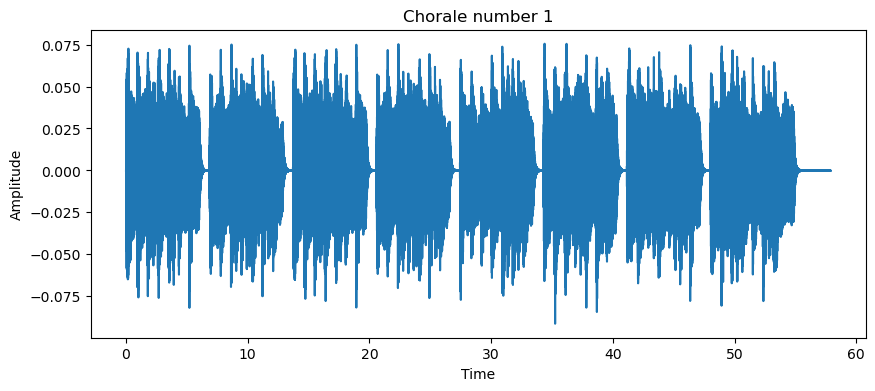

In [2]:
midi_dir = 'chorales/midi'
mix_dir = 'chorales/mix'
number = '1'

# Import audio
fn_wav = os.path.join(mix_dir, f'chorale_{number}_mix.wav')
x,Fs = librosa.load(fn_wav)
time = np.arange(len(x)) / Fs
plt.figure(figsize=(10,4))
plt.title('Chorale number 1')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(time,x)


<audio style="width: 320px;" src="chorales/mix/chorale_1_mix.wav" type="audio/mpeg" controls="controls"></audio>


In [3]:
# Define the function 'extract_annotations'
def extract_annotations(midi_dir, number, source_names, verbose=False):

    start=[]
    duration=[]
    pitch=[]
    velocity=[]
    label=[]
    annotations=[]
    
    for source in source_names:
        midi_file_path = os.path.join(midi_dir, f'chorale_{number}_{source}.mid')
        midi_data = pretty_midi.PrettyMIDI(midi_file_path)
        for instrument in midi_data.instruments:
            for note in instrument.notes:
                start.append(note.start)
                duration.append(note.get_duration())
                pitch.append(note.pitch)
                velocity.append(note.velocity)
                label.append(source)
                annotations.append([note.start, note.get_duration(), note.pitch, note.velocity, source])

            if verbose:
                piano_roll = instrument.get_piano_roll()
                time = np.arange(len(x)) / Fs
                
                plt.figure(figsize=(10,4))
                plt.imshow(piano_roll, aspect='auto', cmap='viridis', origin='lower')
                plt.ylim([40,80])
                plt.title(f'Piano Roll: '+ source)
                plt.xlabel('Time (frames)')
                plt.ylabel('MIDI value')
                plt.show()
            
    return annotations, start, duration, pitch, velocity, label

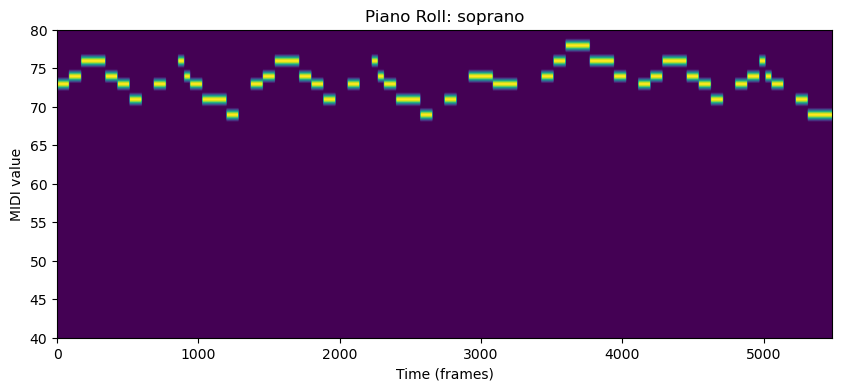

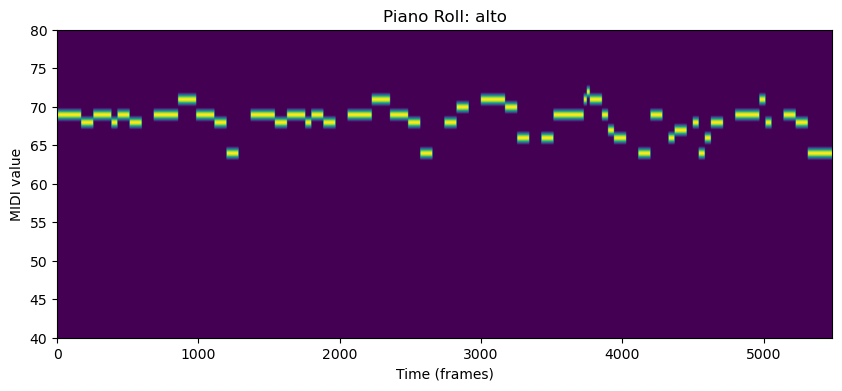

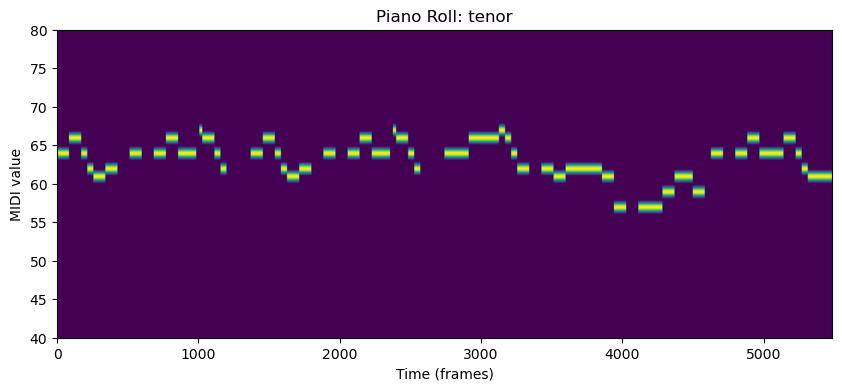

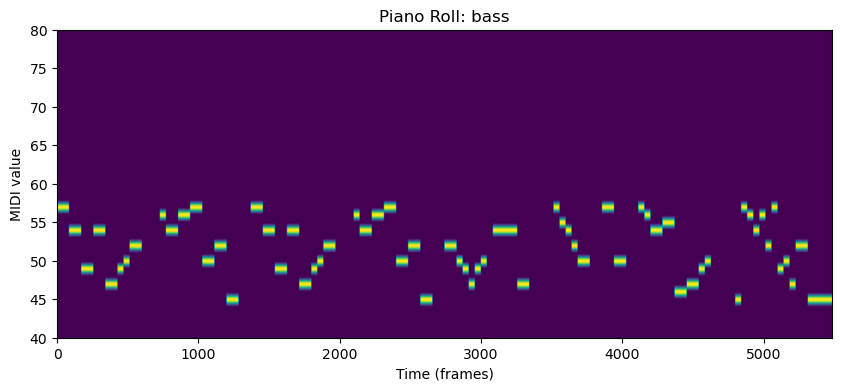

         start  duration  pitch  velocity    label
0     0.000000  0.857143     73        90  soprano
1     0.857143  0.857143     74        90  soprano
2     1.714286  0.857143     76        90  soprano
3     2.571429  0.857143     76        90  soprano
4     3.428572  0.857143     74        90  soprano
..         ...       ...    ...       ...      ...
233  51.000008  0.428571     49        90     bass
234  51.428580  0.428572     50        90     bass
235  51.857152  0.428571     47        90     bass
236  52.285723  0.857143     52        90     bass
237  53.142866  1.714286     45        90     bass

[238 rows x 5 columns]


In [4]:
# Extract annotations
source_names = ['soprano', 'alto', 'tenor', 'bass'] 
annotations, start, duration, pitch, velocity, label = extract_annotations(midi_dir, number, source_names, verbose=True)

# Define DataFrame
df = pandas.DataFrame(annotations, columns=['start', 'duration', 'pitch', 'velocity', 'label'])
print(df)


## Question 2

In [5]:
N_fft = 4096
H_fft = N_fft // 4

# Input Spectrogram
X = librosa.stft(x,n_fft=N_fft, win_length=N_fft, hop_length=H_fft, window='hann')
V = np.log10(1 + np.abs(X))

freq_res = Fs / N_fft
frame_res = H_fft / Fs

# Spectrogram shape
K = np.shape(V)[0]
N = np.shape(V)[1]

# Initialize activations and templates
H_init,pitch_set,label_pitch = nmf_utils.initialize_activation(N, annotations, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1])
W_init = nmf_utils.initialize_template(K, pitch_set, freq_res, tol_pitch=0.05)

# Instantiate NMF model
model = decomposition.NMF(n_components=H_init.shape[0], init='custom', solver='mu', max_iter=1000)
W = model.fit_transform(X=V.astype(np.float64), H=H_init, W=W_init)
H = model.components_

# NMF factorization
approximated_spectrogram = np.dot(W, H)

# Error norm
error_norm = np.linalg.norm(V - approximated_spectrogram, ord=2)
print(f"2-norm of the error: {error_norm}")

2-norm of the error: 16.000547018421653


In [6]:
def plot_spectrogram(X, xax, yax, name_x, name_y, title, num=1, lim=0, X2=None, title2=None):
   
    x_ext = xax[1] / 2
    y_ext = yax[1] / 2
    image_extent = [-x_ext, xax[-1]+x_ext,-y_ext, yax[-1]-y_ext]

        
    if num==1:
        plt.figure(figsize=(9,5))
        plt.imshow(X, extent=image_extent, aspect='auto', origin='lower')
        if lim != 0: 
            plt.ylim([0,lim])
        #plt.colorbar()
        plt.title(title)
        plt.xticks(np.arange(xax[0], xax[-1], step=2.0))
        plt.xlabel(name_x)
        plt.ylabel(name_y)
        plt.show()
    
    if num==2:
        plt.figure(figsize=(12,6))
        
        plt.subplot(1,2,1)
        plt.imshow(X, extent=image_extent, aspect='auto', origin='lower')
        if lim != 0: 
            plt.ylim([0,lim])
        plt.colorbar()
        plt.title(title)
        plt.xticks(np.arange(xax[0], xax[-1], step=10))
        plt.xlabel(name_x)
        plt.ylabel(name_y)

        plt.subplot(1,2,2)
        plt.imshow(X2, extent=image_extent, aspect='auto', origin='lower')
        if lim != 0: 
            plt.ylim([0,lim])
        plt.colorbar()
        plt.title(title2)
        plt.xticks(np.arange(xax[0], xax[-1], step=10))
        plt.xlabel(name_x)
        plt.ylabel(name_y)

        plt.show()
        

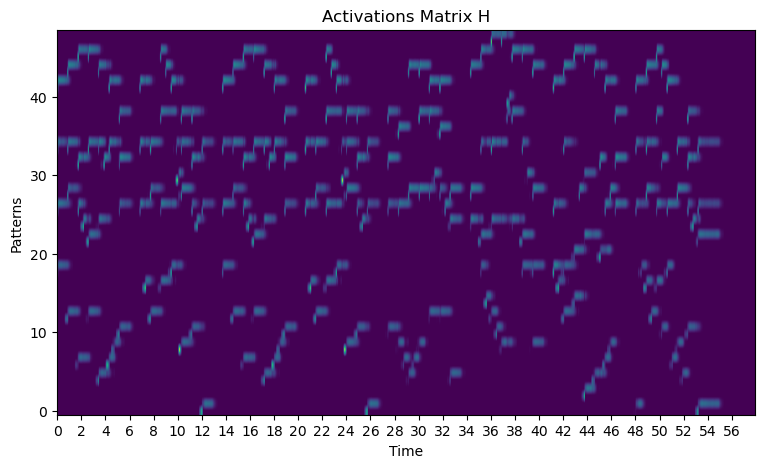

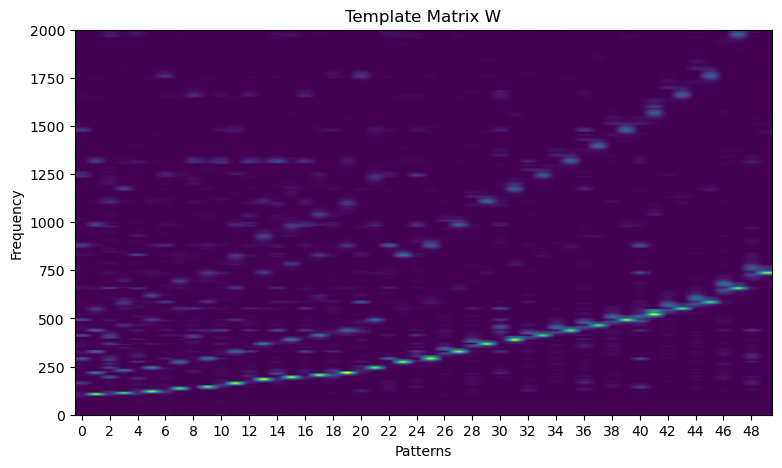

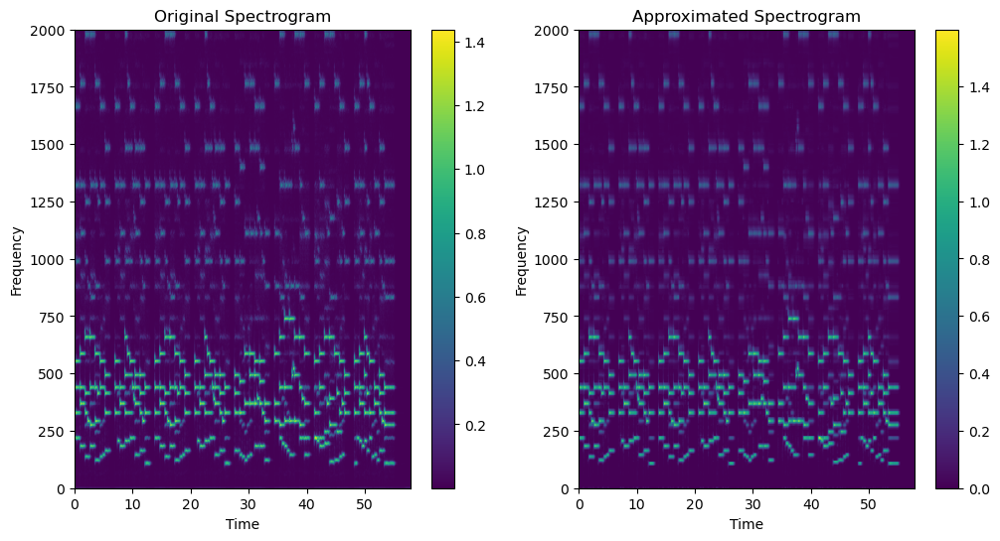

In [7]:
#Plots

time_axis = np.arange(V.shape[1]) / (Fs / H_fft)
frequency_axis = np.arange(V.shape[0]) / (N_fft / Fs)
patterns = np.arange(H.shape[0])
plot_spectrogram(H, time_axis, patterns, "Time", "Patterns", "Activations Matrix H")  
plot_spectrogram(W, patterns, frequency_axis, "Patterns", "Frequency", "Template Matrix W", 1, 2000)
plot_spectrogram(V, time_axis, frequency_axis, "Time", "Frequency", "Original Spectrogram", num=2, lim=2000, X2=approximated_spectrogram,title2="Approximated Spectrogram")


## Question 3

In [8]:
# Define the function 'split annotations'
def split_annotations(annotations):
    ann_sop=[]
    ann_alt=[]
    ann_ten=[]
    ann_bas=[]
    
    for a in annotations:
        if a[4] == "soprano":
            ann_sop.append(a)
        if a[4] == "alto":
            ann_alt.append(a)
        if a[4] == "tenor":
            ann_ten.append(a)
        if a[4] == "bass":
            ann_bas.append(a)   
    return ann_sop, ann_alt, ann_ten, ann_bas

In [9]:
 def plot_three_subplot(W,H_source,source):
    plt.figure(figsize=(15,5))
    
    plt.subplot(1,3,1)
    xax = patterns
    yax = frequency_axis
    image_extent = [-xax[1] / 2, xax[-1]+xax[1] / 2,- yax[1] / 2, yax[-1]- yax[1] / 2]
    plt.imshow(W, extent=image_extent, aspect='auto', origin='lower')
    plt.ylim([0,2000])
    plt.colorbar()
    plt.title("Template Matrix W")
    plt.xlabel("Patterns")
    plt.ylabel("Frequency")

    plt.subplot(1,3,2)
    xax = time_axis
    yax = patterns
    image_extent = [-xax[1] / 2, xax[-1]+xax[1] / 2,- yax[1] / 2, yax[-1]- yax[1] / 2]
    plt.imshow(H_source, extent=image_extent, aspect='auto', origin='lower')
    plt.colorbar()
    plt.title("Activate Matrix: "+source+ " source")
    plt.xlabel("Time")
    plt.ylabel("Patterns")

    plt.subplot(1,3,3)
    xax = time_axis
    yax = frequency_axis
    image_extent = [-xax[1] / 2, xax[-1]+xax[1] / 2,- yax[1] / 2, yax[-1]- yax[1] / 2]
    plt.imshow(np.dot(W,H_source), extent=image_extent, aspect='auto', origin='lower')
    plt.ylim([0,2000])
    plt.colorbar()
    plt.title("Reconstructed Spectrogram: "+source+ " source")
    plt.xlabel("Time")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.show()



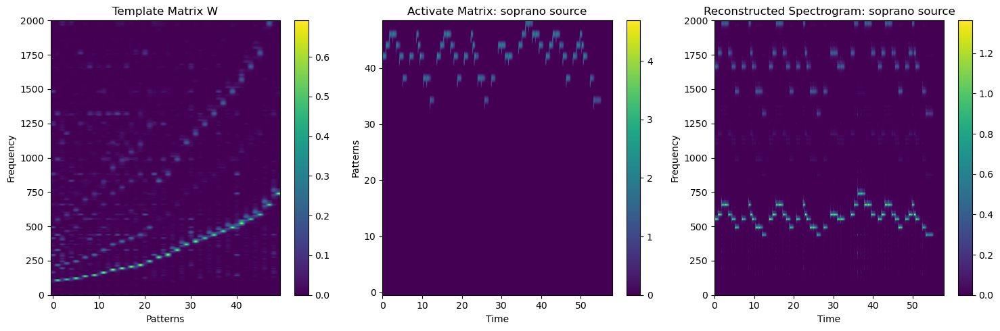

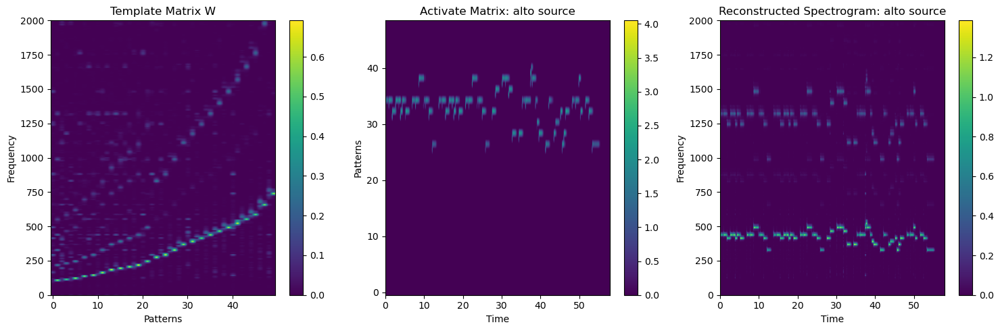

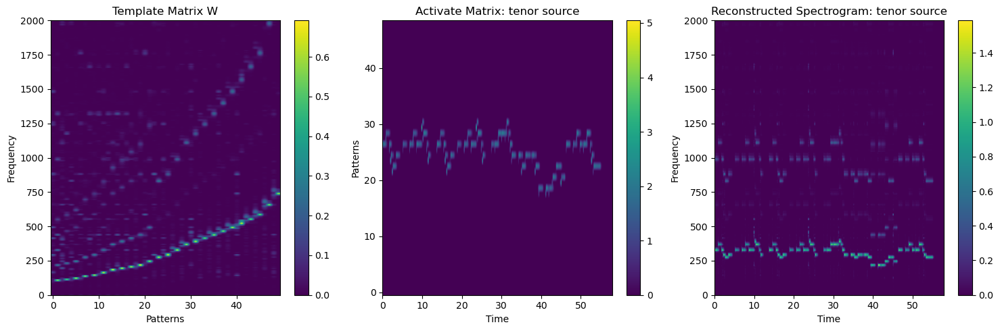

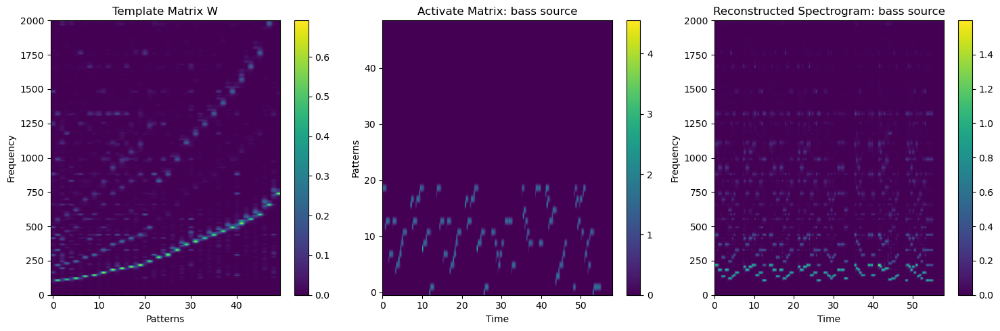

In [10]:
# Split the annotations
ann_sop, ann_alt, ann_ten, ann_bas = split_annotations(annotations)

# Spectral masks for each source
H_init_sop,_,_ = nmf_utils.initialize_activation(N, ann_sop, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
H_init_alt,_,_ = nmf_utils.initialize_activation(N, ann_alt, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
H_init_ten,_,_ = nmf_utils.initialize_activation(N, ann_ten, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
H_init_bas,_,_ = nmf_utils.initialize_activation(N, ann_bas, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)

# Apply spectral masks
H_sop = H * H_init_sop
H_alt = H * H_init_alt
H_ten = H * H_init_ten
H_bas = H * H_init_bas

# Plot first source reconstructions
plot_three_subplot(W,H_sop,"soprano")
plot_three_subplot(W,H_alt,"alto")
plot_three_subplot(W,H_ten,"tenor")
plot_three_subplot(W,H_bas,"bass")


## Question 4

Original signal


Soprane source


Alto source


Tenor source


Bass source


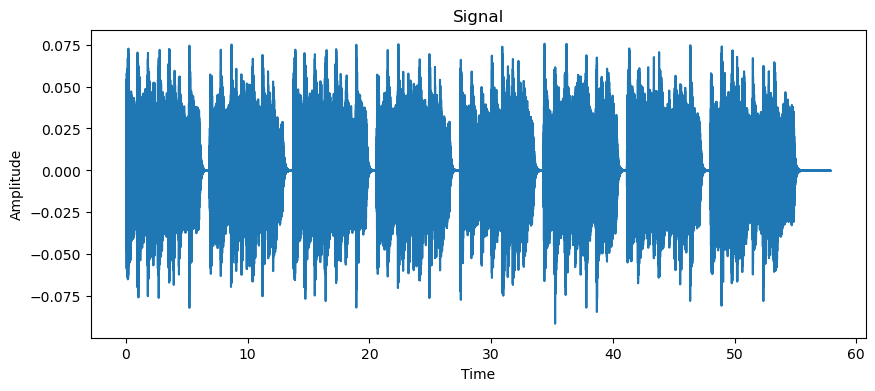

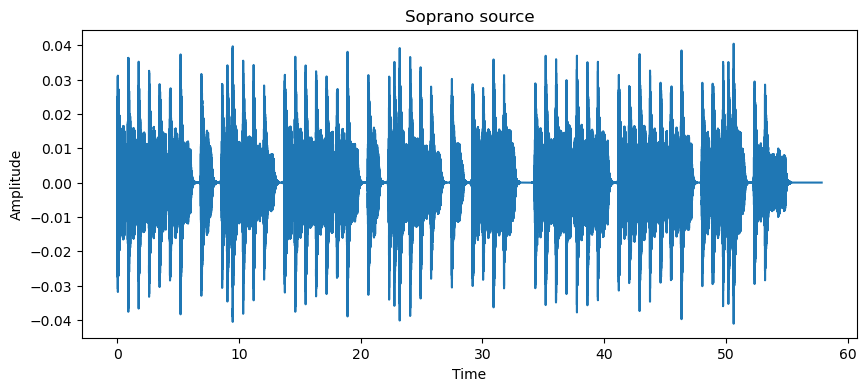

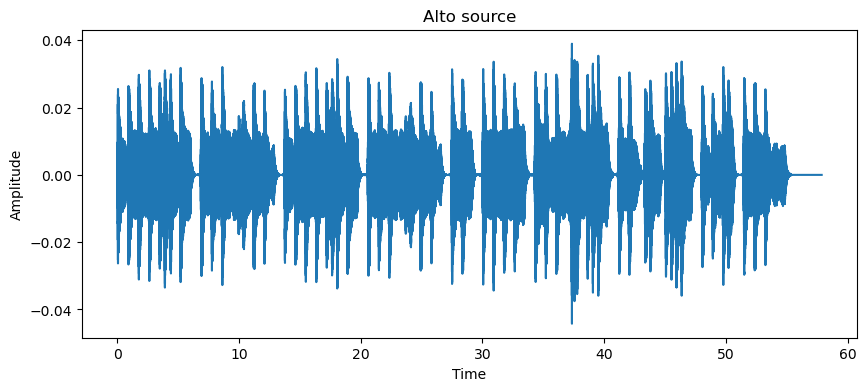

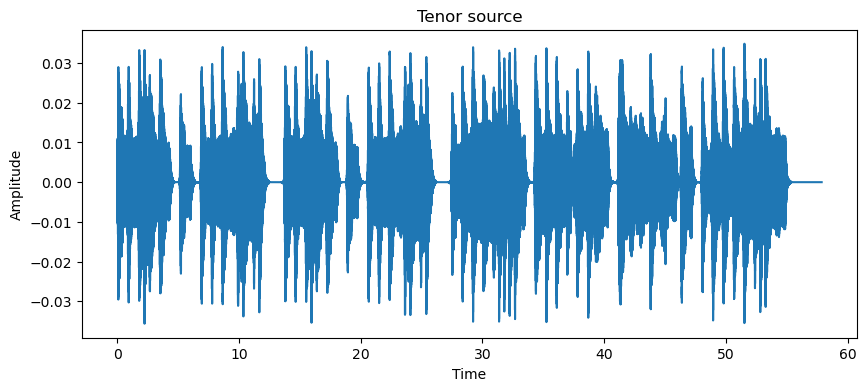

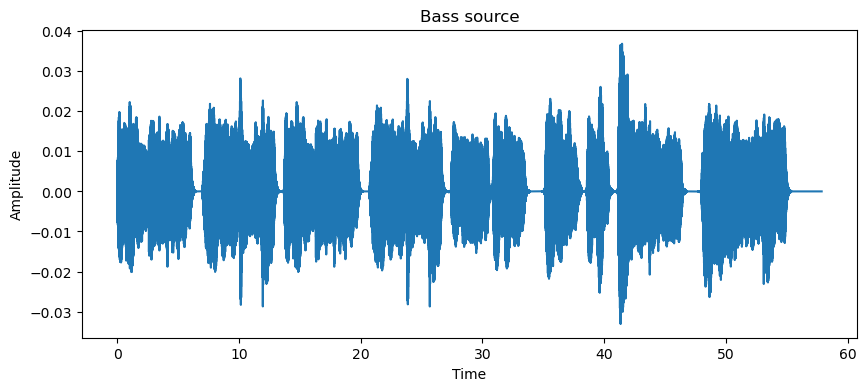

In [11]:
time = np.arange(len(x)) / Fs

plt.figure(figsize=(10,4))
plt.title('Signal')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(time,x)

eps=1e-10

# Soprano source separation
M_sop = np.dot(W,H_sop) / (np.dot(W,H)+eps)
x_sop = librosa.istft(X*M_sop)
plt.figure(figsize=(10,4))
plt.title('Soprano source')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(np.arange(len(x_sop)) / Fs,x_sop)

# Alto source separation
M_alt = np.dot(W,H_alt) / (np.dot(W,H) + eps)
x_alt = librosa.istft(X*M_alt)
plt.figure(figsize=(10,4))
plt.title('Alto source')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(np.arange(len(x_alt)) / Fs,x_alt)

# Tenor source separation
M_ten = np.dot(W,H_ten) / (np.dot(W,H)+eps)
x_ten = librosa.istft(X*M_ten)
plt.figure(figsize=(10,4))
plt.title('Tenor source')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(np.arange(len(x_ten)) / Fs,x_ten)

# Bass source separation
M_bas = np.dot(W,H_bas) / (np.dot(W,H)+eps)
x_bas = librosa.istft(X*M_bas)
plt.figure(figsize=(10,4))
plt.title('Bass source')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.plot(np.arange(len(x_bas)) / Fs,x_bas)

# Listen to the results using ipd.Audio
print("Original signal")
ipd.display(ipd.Audio(x, rate=Fs))
print("Soprane source")
ipd.display(ipd.Audio(x_sop, rate=Fs))
print("Alto source")
ipd.display(ipd.Audio(x_alt, rate=Fs))
print("Tenor source")
ipd.display(ipd.Audio(x_ten, rate=Fs))
print("Bass source")
ipd.display(ipd.Audio(x_bas, rate=Fs))

## Question 5

In [12]:
# Define the function 'separate'
def separate(x, annotations, N_fft=4096, H_fft=1024):

    X = librosa.stft(x,n_fft=N_fft, win_length=N_fft, hop_length=H_fft, window='hann')
    df = pandas.DataFrame(annotations, columns=['start', 'duration', 'pitch', 'velocity', 'label'])

    V = np.log10(1 + np.abs(X))
   
    freq_res = Fs / N_fft
    frame_res = H_fft / Fs

    # Spectrogram shape
    K = np.shape(V)[0]
    N = np.shape(V)[1]

    # Initialize activations and templates: H_init è lunga 2R*N dove R è len pitch_set
    H_init,pitch_set,_ = nmf_utils.initialize_activation(N, annotations, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1])
    W_init = nmf_utils.initialize_template(K, pitch_set, freq_res, tol_pitch=0.05)

    # Instantiate NMF model
    model = decomposition.NMF(n_components=H_init.shape[0], init='custom', solver='mu', max_iter=1000)
    W = model.fit_transform(X=V.astype(np.float64), H=H_init, W=W_init)
    H = model.components_

    # Split the annotations
    ann_sop, ann_alt, ann_ten, ann_bas = split_annotations(annotations)

    # Obtain the spectral masks for each source
    H_init_sop,_,_ = nmf_utils.initialize_activation(N, ann_sop, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
    H_init_alt,_,_ = nmf_utils.initialize_activation(N, ann_alt, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
    H_init_ten,_,_ = nmf_utils.initialize_activation(N, ann_ten, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)
    H_init_bas,_,_ = nmf_utils.initialize_activation(N, ann_bas, frame_res, tol_note=[0.1,0.5], tol_onset=[0.2,0.1], pitch_set=pitch_set)

    # Apply spectral masks
    H_sop = H * H_init_sop
    H_alt = H * H_init_alt
    H_ten = H * H_init_ten
    H_bas = H * H_init_bas

    eps=1e-10

    # Source separation masks
    M_sop = np.dot(W,H_sop) / (np.dot(W,H)+eps)
    x_sop = librosa.istft(X*M_sop)

    M_alt = np.dot(W,H_alt) / (np.dot(W,H)+eps)
    x_alt = librosa.istft(X*M_alt)

    M_ten = np.dot(W,H_ten) / (np.dot(W,H)+eps)
    x_ten = librosa.istft(X*M_ten)

    M_bas = np.dot(W,H_bas) / (np.dot(W,H)+eps)
    x_bas = librosa.istft(X*M_bas)

    return x_sop, x_alt, x_ten, x_bas

In [13]:
def same_len(x1,x2):
    max_length = max(len(x1), len(x2))
    pad_x1 = max_length - len(x1)
    pad_x2 = max_length - len(x2)
    y1 = np.pad(x1, (0, pad_x1), mode='constant')
    y2 = np.pad(x2, (0, pad_x2), mode='constant')
    
    return y1,y2

In [14]:
def SDR(x, x_sep):
    
    y1,y2 = same_len(x,x_sep)
    
    sdr,_,_,_ = mir_eval.separation.bss_eval_sources(y1, y2)
    return sdr

In [ ]:
# Write a pipeline for separating all the chorales into their sources
number = ['1','2','3','4']
midi_dir = 'chorales/midi'
mix_dir = 'chorales/mix'
wav_dir = 'chorales/wav'
source_names = ['soprano', 'alto', 'tenor', 'bass'] 

for n in number:  
    
    # Load wav files
    wav = os.path.join(mix_dir, f'chorale_{n}_mix.wav') #wav mischiato
    y,Fs = librosa.load(wav)
    
    # Extract annotations and call separate function
    annotations_n = extract_annotations(midi_dir, n, source_names) #midi separato
    x_sop, x_alt, x_ten, x_bas = separate(y, annotations_n[0]) #wav mischiato
    x_separated = [x_sop, x_alt, x_ten, x_bas]

    # Load original separate wav file
    x_originals = []
    for s in source_names:
        wav_or = os.path.join(wav_dir, f'chorale_{n}_{s}.wav')
        x_or,Fs = librosa.load(wav_or)
        x_originals.append(x_or)
    
    print("\nCHORALE NUMBER " + n + "\n")
        
    # Print Audio and SDR
    print("Original signal")
    ipd.display(ipd.Audio(y, rate=Fs))
    
    sdr1 = SDR (x_originals[0], x_separated[0])
    print(f' Soprane Source\t SDR = {sdr1}')
    ipd.display(ipd.Audio(x_sop, rate=Fs))
    
    sdr2 = SDR (x_originals[1], x_separated[1])
    print(f' Alto Source\t SDR = {sdr2}')
    ipd.display(ipd.Audio(x_alt, rate=Fs))
    
    sdr3 = SDR (x_originals[2], x_separated[2])
    print(f' Tenor Source\t SDR = {sdr3}')
    ipd.display(ipd.Audio(x_ten, rate=Fs))
    
    sdr4 = SDR (x_originals[3], x_separated[3])
    print(f' Bass Source\t SDR = {sdr4}')
    ipd.display(ipd.Audio(x_bas, rate=Fs))



CHORALE NUMBER 1

Original signal
